In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters)

In [3]:
kdata = make_k(-67)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
sigmas = singular_points_new(k)
assert sigmas == [inf]

M_alphas, alpha_inv = make_M_alphas(alphas)

In [5]:
polys, hemis = all_polyhedra(k)

New orbit from P_0=[27/67*w + 20/67, 2/67]: {0}
New orbit from P_1=[-27/67*w + 47/67, 2/67]: {1}
New orbit from P_2=[-26/67*w - 28/201, 20/603]: {2, 5, 6}
New orbit from P_3=[26/67*w + 28/201, 20/603]: {3, 4, 7}
New orbit from P_8=[-53/134*w + 23/201, 95/2412]: {17, 8, 11, 12, 15}
New orbit from P_9=[53/134*w - 23/201, 95/2412]: {16, 9, 10, 13, 14}
New orbit from P_18=[69/335*w + 133/335, 66/1675]: {18, 21}
New orbit from P_19=[-69/335*w + 202/335, 66/1675]: {19, 20}
New orbit from P_22=[31/134*w + 9/67, 11/268]: {24, 27, 22}
New orbit from P_23=[-31/134*w - 9/67, 11/268]: {25, 26, 23}
New orbit from P_28=[29/134*w + 62/201, 101/2412]: {32, 35, 36, 28, 31}
New orbit from P_29=[-29/134*w - 62/201, 101/2412]: {33, 34, 37, 29, 30}
New orbit from P_38=[16/67*w - 8/67, 3/67]: {38}
New orbit from P_39=[-16/67*w + 8/67, 3/67]: {39}
Found [[38], [3, 4, 7], [17, 8, 11, 12, 15], [18, 21], [24, 27, 22], [25, 26, 23], [39], [33, 34, 37, 29, 30], [1], [32, 35, 36, 28, 31], [2, 5, 6], [19, 20], [16,

In [6]:
assert len(polys)==14

We should have 2 hexagonal caps, 4 triangular prisms, and 2 truncated tetrahedra

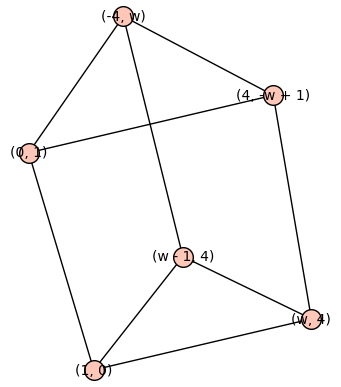

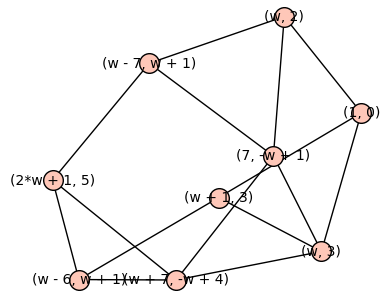

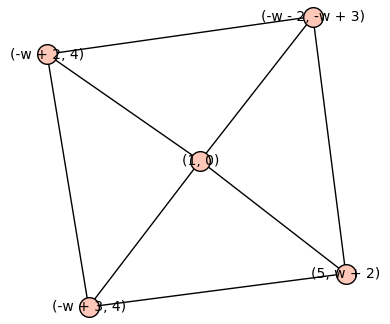

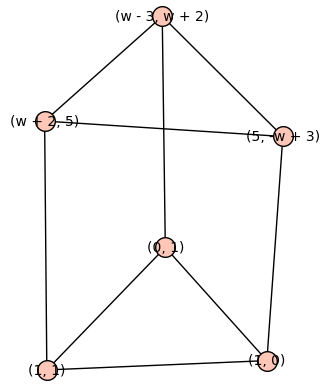

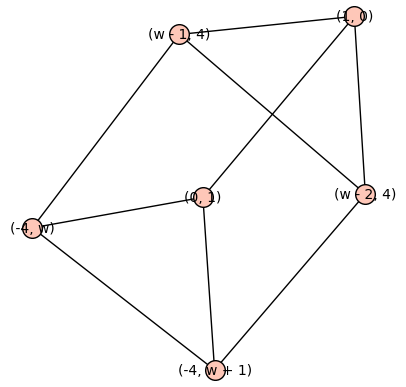

...

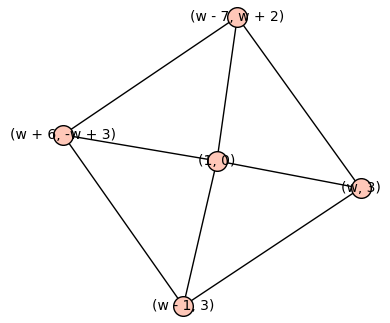

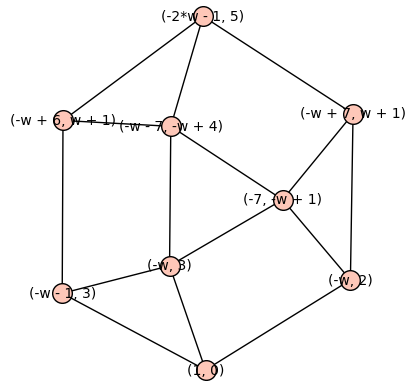

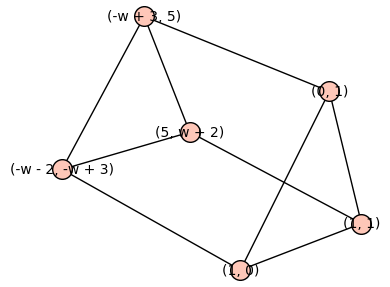

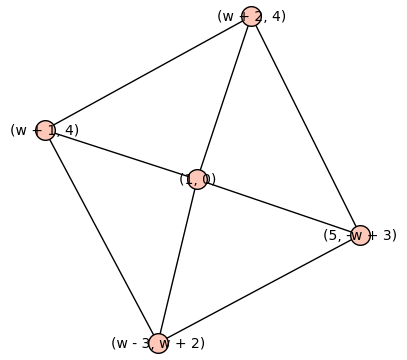

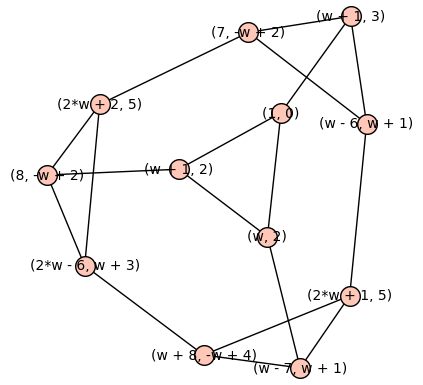

In [7]:
for G in polys: show(G) 

In [8]:
triangles = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
#aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [9]:
[len(t) for t in [aaa_triangles, squares, hexagons]]

[44, 28, 10]

In [10]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [11]:
[len(t) for t in [aaa_triangles0, squares0, hexagons0]]

[9, 4, 1]

In [12]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

[[[0, 11, 0, 11], [0, 0, 0]],
 [[5, 10, 6, 1], [0, 0, 0]],
 [[19, 0, 17, 1], [1, 0, 0]],
 [[14, 8, 13, 0], [-1, 0, 0]]]

In [13]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w:-4], oo, [-w + 1:-4]],
 [[w + 1:3], oo, [w + 2:3]],
 [[-w - 2:-w + 3], oo, [-5:-w - 2]],
 [[-w:-3], oo, [-w - 1:-4]],
 [[-w - 1:-4], oo, [-w:-4]],
 [[-w + 2:-4], oo, [-w + 1:-3]],
 [[w - 3:-w - 2], oo, [0:1]]]

In [14]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

[[9, 11, 9],
 [4, 5, 7],
 [2, 17, 22],
 [3, 13, 18],
 [13, 9, 14],
 [16, 6, 23],
 [23, 0, 18]]

In [15]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object

In [16]:
from polyhedra import all_poly_types, poly_types

In [17]:
poly_types(polys)

{'tetrahedron': 0,
 'square prism': 4,
 'triangular prism': 6,
 'hexagonal cap': 2,
 'truncated tetrahedron': 2,
 'cuboctahedron': 0}

In [18]:
all_poly_types(polys)

['triangular prism',
 'hexagonal cap',
 'square prism',
 'triangular prism',
 'triangular prism',
 'triangular prism',
 'triangular prism',
 'square prism',
 'truncated tetrahedron',
 'square prism',
 'hexagonal cap',
 'triangular prism',
 'square prism',
 'truncated tetrahedron']